# Data Cleaning, Visualization, Preliminary Analysis

by Winston Chiong

In [1]:
import time 
import numpy as np 
import pandas as pd
import seaborn as sns 
import matplotlib.pyplot as plt
import plotly.express as px 

Let's see what our dataset looks like.

In [2]:
original_df = pd.read_csv("data/slrpEV11052020-09222022.csv")
pd.set_option('display.max_columns' , None)
original_df.head()

,dcosId,userId,vehicle_model,vehicle_maxChgRate_W,siteId,stationId,connectTime,startChargeTime,Deadline,energyReq_Wh,estCost,reg_centsPerHr,sch_centsPerHr,sch_centsPerKwh,sch_centsPerOverstayHr,Duration,DurationHrs,choice,regular,scheduled,cumEnergy_Wh,peakPower_W,power,lastUpdate
0,24,605,500e,6600,23,7,2020-11-05T10:30:16,2020-11-05T10:31:09,NaN,NaN,5.35224,130.0,9.0,15.0,200.0,0 days 03:43:57,3.73249,REGULAR,1,0,3281.0,6335,"[{'power_W': Decimal('6259'), 'timestamp': Dec...",2020-11-05T14:15:06
1,26,486,Model 3,24000,23,3,2020-11-11T07:39:55,2020-11-11T07:39:59,NaN,NaN,10.75291,150.0,3.0,15.0,200.0,0 days 06:50:07,6.83527,REGULAR,1,0,33458.0,7005,"[{'power_W': Decimal('0'), 'timestamp': Decima...",2020-11-11T14:30:06
2,30,620,Volt,3600,25,12,2020-11-13T16:19:55,2020-11-13T16:20:06,2020-11-14T04:15:00,18400.0,29.32211,180.0,3.0,12.0,300.0,0 days 20:40:02,20.66722,SCHEDULED,0,1,15216.0,3450,"[{'power_W': Decimal('0'), 'timestamp': Decima...",2020-11-14T13:00:08
3,31,618,Bolt EV,7200,23,6,2020-11-14T23:47:06,2020-11-14T23:47:16,NaN,NaN,3.82125,150.0,3.0,18.0,400.0,0 days 02:12:51,2.21416,REGULAR,1,0,14378.0,6889,"[{'power_W': Decimal('6889'), 'timestamp': Dec...",2020-11-15T02:00:07
4,32,623,B-Class Electric Drive,6000,23,9,2020-11-16T11:38:44,2020-11-16T11:42:22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0 days 03:12:45,3.21249,REGULAR,1,0,12484.0,6852,"[{'power_W': Decimal('6813'), 'timestamp': Dec...",2020-11-16T14:55:07


### Extracting Power and Time

Our main column of concern is the column labeled `power`, where each row represents power usage by a unique user, and the nested structure shows power (Watts) at a particular point in time (represented in Unix time).

Here's what the first record looks like.

In [3]:
original_df["power"][0]

"[{'power_W': Decimal('6259'), 'timestamp': Decimal('1604601308')}, {'power_W': Decimal('6269'), 'timestamp': Decimal('1604601606')}, {'power_W': Decimal('6298'), 'timestamp': Decimal('1604601906')}, {'power_W': Decimal('6318'), 'timestamp': Decimal('1604602206')}, {'power_W': Decimal('6335'), 'timestamp': Decimal('1604602506')}, {'power_W': Decimal('5809'), 'timestamp': Decimal('1604602806')}, {'power_W': Decimal('3589'), 'timestamp': Decimal('1604603106')}, {'power_W': Decimal('0'), 'timestamp': Decimal('1604603406')}, {'power_W': Decimal('0'), 'timestamp': Decimal('1604603706')}, {'power_W': Decimal('0'), 'timestamp': Decimal('1604604011')}, {'power_W': Decimal('0'), 'timestamp': Decimal('1604604306')}, {'power_W': Decimal('0'), 'timestamp': Decimal('1604604606')}, {'power_W': Decimal('0'), 'timestamp': Decimal('1604604906')}, {'power_W': Decimal('0'), 'timestamp': Decimal('1604605206')}, {'power_W': Decimal('0'), 'timestamp': Decimal('1604605506')}, {'power_W': Decimal('0'), 'times

Each instance is enclosed by curly braces and separated by commas.

Let's unnest the data and clean it up:

1. Pattern match `[{'power_W': Decimal('`, `{'power_W': Decimal('`, `')`, `'timestamp': Decimal('`, `')}`, and `')}]`. That way, we're left with strings, in alternating power and UNIX time.
2. Split our string on each `, ` delimiter and cast our `str` values to `int` values. 

In [4]:
#1
pattern = r"(\[?\{'power_W':\sDecimal\(')|('timestamp':\sDecimal\(')|('\)\}?\]?)"
power_and_time = original_df["power"].str.replace(pattern , "" , regex = True) # remove all pattern instances 

#2
power_and_time = power_and_time.str.split(', ')
power_and_time = power_and_time.apply(lambda lst : [int(val) for val in lst]) # cast all str value to int

power_and_time

0       [6259, 1604601308, 6269, 1604601606, 6298, 160...
1       [0, 1605109206, 6978, 1605109506, 6987, 160510...
2       [0, 1605313212, 3425, 1605313507, 3426, 160531...
3       [6889, 1605426607, 6873, 1605426907, 6867, 160...
4       [6813, 1605555907, 6822, 1605556207, 6821, 160...
                              ...                        
2054    [3327, 1661173813, 2921, 1661174108, 2874, 166...
2055    [4155, 1661178618, 6233, 1661178907, 6237, 166...
2056    [6625, 1661194208, 6628, 1661194507, 6624, 166...
2057    [0, 1661197808, 6670, 1661198107, 6622, 166119...
2058    [6, 1661202907, 3327, 1661203207, 3327, 166120...
Name: power, Length: 2059, dtype: object

Notice that power values start at index 0, and occurs every other value. Time values start at index 1, and similarly occurs every other value. We can easily extract separate power and time Series objects through slicing.


In [5]:
power_vals = power_and_time.apply(lambda x : x[::2])
time_vals = power_and_time.apply(lambda x : x[1::2])

Since our power and time Series objects are nested, we can call the `.explode()` method to unnest our data.

In [6]:
power_vals = power_vals.explode()
time_vals = time_vals.explode()

[UNIX time](https://en.wikipedia.org/wiki/Unix_time) is a system for describing a point in time. It is the number of seconds that have elapsed since the Unix epoch, excluding leap seconds. The Unix epoch is 00:00:00 UTC on 1 January 1970 (an arbitrary date). 

UNIX time is a little hard to interpret, so let's convert UNIX time to a human-readable datetime.

Let's define a function that does the following : 
1. Some of our UNIX time aren't exactly 5 minutes apart, so let's round every UNIX time value up 5 minutes. We can do this as such:
    * ```time_vals = time_vals // (5 * 60) * (5*60) + (5*60)``` 
    * We round down the number of 5 minute intervals (UNIX time is now divisible by 300 seconds), convert back to UNIX time, then add 5 minutes.  
2. Convert UNIX time to the form ```year-month-day hour:minute```, Pacific Standard Time.

In [7]:
def round_format_UNIX_time(time_value):
    """Function takes in a UNIX time value, and rounds this value up 5 minutes.
    The time value is then converted into the format year-month-day hour:minute."""
    
    # round time up 5 minutes 
    time_value = time_value // (5 * 60) * (5*60) + (5*60)
    
    # format time value
    time_value = time.strftime('%Y-%m-%d %H:%M', time.localtime(time_value))
    
    return time_value 

Let's apply our function to every value in our `time_vals` Series object.

In [8]:
time_vals = time_vals.apply(round_format_UNIX_time)
time_vals

0       2020-11-05 10:40
0       2020-11-05 10:45
0       2020-11-05 10:50
0       2020-11-05 10:55
0       2020-11-05 11:00
              ...       
2058    2022-08-22 16:55
2058    2022-08-22 17:00
2058    2022-08-22 17:05
2058    2022-08-22 17:10
2058    2022-08-22 17:15
Name: power, Length: 112684, dtype: object

Let's create a temporary dataframe from our power and time values and join this with our original dataframe.

In [9]:
temp = pd.DataFrame({"time" : time_vals , "power_demand" : power_vals}) 
master_df = original_df.join(temp)
master_df.head()

,dcosId,userId,vehicle_model,vehicle_maxChgRate_W,siteId,stationId,connectTime,startChargeTime,Deadline,energyReq_Wh,estCost,reg_centsPerHr,sch_centsPerHr,sch_centsPerKwh,sch_centsPerOverstayHr,Duration,DurationHrs,choice,regular,scheduled,cumEnergy_Wh,peakPower_W,power,lastUpdate,time,power_demand
0,24,605,500e,6600,23,7,2020-11-05T10:30:16,2020-11-05T10:31:09,NaN,NaN,5.35224,130.0,9.0,15.0,200.0,0 days 03:43:57,3.73249,REGULAR,1,0,3281.0,6335,"[{'power_W': Decimal('6259'), 'timestamp': Dec...",2020-11-05T14:15:06,2020-11-05 10:40,6259
0,24,605,500e,6600,23,7,2020-11-05T10:30:16,2020-11-05T10:31:09,NaN,NaN,5.35224,130.0,9.0,15.0,200.0,0 days 03:43:57,3.73249,REGULAR,1,0,3281.0,6335,"[{'power_W': Decimal('6259'), 'timestamp': Dec...",2020-11-05T14:15:06,2020-11-05 10:45,6269
0,24,605,500e,6600,23,7,2020-11-05T10:30:16,2020-11-05T10:31:09,NaN,NaN,5.35224,130.0,9.0,15.0,200.0,0 days 03:43:57,3.73249,REGULAR,1,0,3281.0,6335,"[{'power_W': Decimal('6259'), 'timestamp': Dec...",2020-11-05T14:15:06,2020-11-05 10:50,6298
0,24,605,500e,6600,23,7,2020-11-05T10:30:16,2020-11-05T10:31:09,NaN,NaN,5.35224,130.0,9.0,15.0,200.0,0 days 03:43:57,3.73249,REGULAR,1,0,3281.0,6335,"[{'power_W': Decimal('6259'), 'timestamp': Dec...",2020-11-05T14:15:06,2020-11-05 10:55,6318
0,24,605,500e,6600,23,7,2020-11-05T10:30:16,2020-11-05T10:31:09,NaN,NaN,5.35224,130.0,9.0,15.0,200.0,0 days 03:43:57,3.73249,REGULAR,1,0,3281.0,6335,"[{'power_W': Decimal('6259'), 'timestamp': Dec...",2020-11-05T14:15:06,2020-11-05 11:00,6335


From the master dataframe, let's extract power and time to a sub dataframe.

Multiple users can be charging their EV's at the same time, so let's sum power values if they occur at the same time. Let's also sort our time values. 

In [10]:
df_power_time = master_df[["time" , "power_demand"]]

df_power_time = df_power_time.groupby("time").sum()

df_power_time = df_power_time.sort_values(by = "time")
df_power_time

,power_demand
time,
2020-11-05 10:40,6259
2020-11-05 10:45,6269
2020-11-05 10:50,6298
2020-11-05 10:55,6318
2020-11-05 11:00,6335
...,...
2022-08-22 16:55,0
2022-08-22 17:00,0
2022-08-22 17:05,0


In [11]:
# df_power_time["temp"] = df_power_time["Connected Users"].apply(lambda x: 834 in x) 
# df_power_time = df_power_time.loc[df_power_time["temp"] == True]
# df_power_time.drop(columns = ["temp"], inplace=True)
# df_power_time

### Upsampling Time Series

If no one is recorded charging their EV, there shouldn't be any power consumption. If we were to line plot our data right now, data points would be linearly interpolated, which doesn't reflect reality. 

Our time stamps are recorded at irregular intervals, with many gaps. Let's upsample our time series to fill gaps where `power` should be zero. 

We can do this in two steps :
1. Convert our ```time_vals``` column to datatime objects (which pandas can resample).
2. We can resample our datetime index into 5 minute bins. We can call ```sum()``` on our sample object, as ```NaN``` (missing times) sums to zero. 

In [12]:
df_power_time.index = pd.to_datetime(df_power_time.index)
df_power_time = df_power_time.resample("5min").sum()
df_power_time

,power_demand
time,
2020-11-05 10:40:00,6259
2020-11-05 10:45:00,6269
2020-11-05 10:50:00,6298
2020-11-05 10:55:00,6318
2020-11-05 11:00:00,6335
...,...
2022-08-22 16:55:00,0
2022-08-22 17:00:00,0
2022-08-22 17:05:00,0


### Calendar Variables

It might be helpful to append our dataframe with one-hot encoded calendar features, for example, $X_{monday} = 1$ if Monday, $X_{monday} = 0$ if not. 

In [13]:
from sklearn.preprocessing import OneHotEncoder

# add a new column with the name of the day of the week 
df_power_time["day"] = df_power_time.index.day_name()

def ohe_day_name(data):
    """This function takes in dataframe with a column 'day', which consists of the name of the day of the week, and one-hot encodes
    the day of the week."""
    oh_enc = OneHotEncoder()
    temp = pd.DataFrame(oh_enc.fit_transform(data[["day"]]).toarray() , columns = oh_enc.get_feature_names_out() , index = df_power_time.index)
    return pd.concat([df_power_time , temp] , axis = 1)

df_power_time = ohe_day_name(df_power_time)

# rename and reorder columns 
df_power_time.rename(columns = {"day_Friday":"Friday", "day_Monday":"Monday",
                                                "day_Saturday":"Saturday", "day_Sunday":"Sunday" ,
                                                "day_Thursday":"Thursday", "day_Tuesday":"Tuesday",
                                                "day_Wednesday":"Wednesday"} , inplace = True)

df_power_time.head()

,power_demand,day,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
time,,,,,,,,,
2020-11-05 10:40:00,6259,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2020-11-05 10:45:00,6269,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2020-11-05 10:50:00,6298,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2020-11-05 10:55:00,6318,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2020-11-05 11:00:00,6335,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0


We can do the same for other calendar variables, such as school vacations, holidays, etc. 

**List of Exogenous Calendar Variables :**

| Calendar Variables |
|--------------------|
| Monday             |
| Tuesday            |
| Wednesday          |
| Thursday           |
| Friday             |
| Saturday           |
| Sunday             |
| Summer Break       |
| Winter Break       |
| Spring Break       |
| Thanksgiving Break |      
| Federal Holiday    |

Note that UC Berkeley's summer, winter, spring, and Thanksgiving break will need to be hardcoded, as I can't find a structured way to pull them through Python. 

In [14]:
from pandas.tseries.holiday import USFederalHolidayCalendar

# import federal holidays calendar 
calendar = USFederalHolidayCalendar() 
holidays = calendar.holidays(start=df_power_time.index[0], end=df_power_time.index[-1])

# round index to midnight, compare to holidays index, and cast Boolean values to binary   
df_power_time["Federal Holiday"] = df_power_time.index.normalize().isin(holidays)
df_power_time["Federal Holiday"]  = df_power_time["Federal Holiday"].astype(int)
df_power_time

,power_demand,day,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,Federal Holiday
time,,,,,,,,,,
2020-11-05 10:40:00,6259,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0
2020-11-05 10:45:00,6269,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0
2020-11-05 10:50:00,6298,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0
2020-11-05 10:55:00,6318,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0
2020-11-05 11:00:00,6335,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...
2022-08-22 16:55:00,0,Monday,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0
2022-08-22 17:00:00,0,Monday,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0
2022-08-22 17:05:00,0,Monday,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0


In [15]:
print(f"Start record: {df_power_time.index[0]} | End record: {df_power_time.index[-1]}")

Start record: 2020-11-05 10:40:00 | End record: 2022-08-22 17:15:00


In [16]:
# Convention: 
# Start: Monday after break 
# Stop: day before start of instruction 
academic_breaks_ranges = [["2020-11-26" , "2020-11-27"] , ["2020-12-21" , "2021-01-11"] , ["2021-03-22" , "2021-03-28"] , ["2021-05-17" , "2021-08-17"] ,
                   ["2021-12-20" , "2022-01-10"] , ["2022-03-21" , "2022-03-27"] , ["2022-05-16" , "2022-08-16"]]

In [17]:
# Can't create empty DateTimeIndex object; manually add first entries 
academic_breaks = pd.date_range(academic_breaks_ranges[0][0] , academic_breaks_ranges[0][1]) 

# append date ranges to DateTimeIndex object
for break_range in academic_breaks_ranges[1:] :
    academic_breaks = academic_breaks.union(pd.date_range(break_range[0] , break_range[1]))
academic_breaks

DatetimeIndex(['2020-11-26', '2020-11-27', '2020-12-21', '2020-12-22',
               '2020-12-23', '2020-12-24', '2020-12-25', '2020-12-26',
               '2020-12-27', '2020-12-28',
               ...
               '2022-08-07', '2022-08-08', '2022-08-09', '2022-08-10',
               '2022-08-11', '2022-08-12', '2022-08-13', '2022-08-14',
               '2022-08-15', '2022-08-16'],
              dtype='datetime64[ns]', length=246, freq=None)

In [18]:
# round index to midnight, compare to academic break index, and cast Boolean values to binary   
df_power_time["Academic Break"] = df_power_time.index.normalize().isin(academic_breaks)
df_power_time["Academic Break"]  = df_power_time["Academic Break"].astype(int)
df_power_time

,power_demand,day,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,Federal Holiday,Academic Break
time,,,,,,,,,,,
2020-11-05 10:40:00,6259,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,0
2020-11-05 10:45:00,6269,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,0
2020-11-05 10:50:00,6298,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,0
2020-11-05 10:55:00,6318,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,0
2020-11-05 11:00:00,6335,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
2022-08-22 16:55:00,0,Monday,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0,0
2022-08-22 17:00:00,0,Monday,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0,0
2022-08-22 17:05:00,0,Monday,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0,0


### 5-Min Aggregated Power Demand DataFrame

In [19]:
df_power_time.to_csv("data/5minpowerdemand.csv")
df_power_time.head()

,power_demand,day,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,Federal Holiday,Academic Break
time,,,,,,,,,,,
2020-11-05 10:40:00,6259,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,0
2020-11-05 10:45:00,6269,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,0
2020-11-05 10:50:00,6298,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,0
2020-11-05 10:55:00,6318,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,0
2020-11-05 11:00:00,6335,Thursday,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,0


### Hourly Energy Demand DataFrame

Let's create an *total hourly energy demand* dataframe, as this will be useful later. Export this dataframe to a `.csv` file.

In [20]:
hourly_energy_demand_df = df_power_time.resample("1H").agg({"power_demand":"sum","day":"first",
                                                           "Monday":"first","Tuesday":"first","Wednesday":"first","Thursday":"first","Friday":"first",
                                                           "Saturday":"first","Sunday":"first",
                                                           "Federal Holiday":"first", "Academic Break":"first"})
hourly_energy_demand_df["power_demand"] = hourly_energy_demand_df["power_demand"]/1000
hourly_energy_demand_df["power_demand"] = hourly_energy_demand_df["power_demand"]/12 # convert to kWh
hourly_energy_demand_df.rename(columns={"power_demand":"energy_demand"}, inplace=True) 
hourly_energy_demand_df.to_csv("data/hourlyenergydemand.csv")
hourly_energy_demand_df.head()

,energy_demand,day,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,Federal Holiday,Academic Break
time,,,,,,,,,,,
2020-11-05 10:00:00,2.095333,Thursday,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0,0
2020-11-05 11:00:00,1.311083,Thursday,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0,0
2020-11-05 12:00:00,0.000000,Thursday,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0,0
2020-11-05 13:00:00,0.000000,Thursday,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0,0
2020-11-05 14:00:00,0.000000,Thursday,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0,0


### Connected Users DataFrame

To get a connected users dataframe, we can follow a similar process to obtaining 5-min aggregate power demand. We can resample into desired granularity and call ```unique``` to group all unique connected EV users.

#### 5-Min Granularity

In [21]:
connected_users_5min_df = master_df[["time", "userId"]]

# set index and change to datetime
connected_users_5min_df.set_index("time", inplace=True)
connected_users_5min_df.index = pd.to_datetime(connected_users_5min_df.index)

# Resample, and store unique userId's
connected_users_5min_df = connected_users_5min_df.resample("5min").agg({"userId":"unique"})

# # create number of connected users feature
connected_users_5min_df["Number Connected Users"] = connected_users_5min_df["userId"].apply(lambda x: x.shape[0])

connected_users_5min_df.head()

,userId,Number Connected Users
time,,
2020-11-05 10:40:00,[605],1
2020-11-05 10:45:00,[605],1
2020-11-05 10:50:00,[605],1
2020-11-05 10:55:00,[605],1
2020-11-05 11:00:00,[605],1


#### Hourly Granularity

In [22]:
connected_users_hourly_df = master_df[["time", "userId"]]

# set index and change to datetime
connected_users_hourly_df.set_index("time", inplace=True)
connected_users_hourly_df.index = pd.to_datetime(connected_users_hourly_df.index)

# Resample, and store unique userId's
connected_users_hourly_df = connected_users_hourly_df.resample("1H").agg({"userId":"unique"})

# # create number of connected users feature
connected_users_hourly_df["Number Connected Users"] = connected_users_hourly_df["userId"].apply(lambda x: x.shape[0])

connected_users_hourly_df.head()

,userId,Number Connected Users
time,,
2020-11-05 10:00:00,[605],1
2020-11-05 11:00:00,[605],1
2020-11-05 12:00:00,[605],1
2020-11-05 13:00:00,[605],1
2020-11-05 14:00:00,[605],1


### Visualization

In [23]:
import plotly.graph_objs as go

# look into plotly_resampler for less lag with figures

#### Number of Connected Users (5 Minutes)

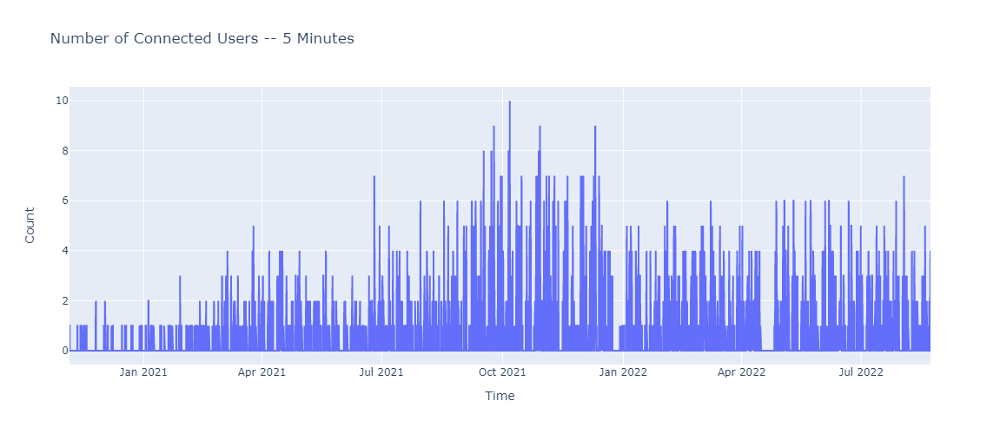

In [24]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=connected_users_5min_df.index, y=connected_users_5min_df["Number Connected Users"], hovertext=df_power_time["day"]))

# title and axes labels
fig.update_layout(title="Number of Connected Users -- 5 Minutes", xaxis_title="Time", yaxis_title="Count", height=500)

fig.show()

#### Number of Connected Users (Hourly)

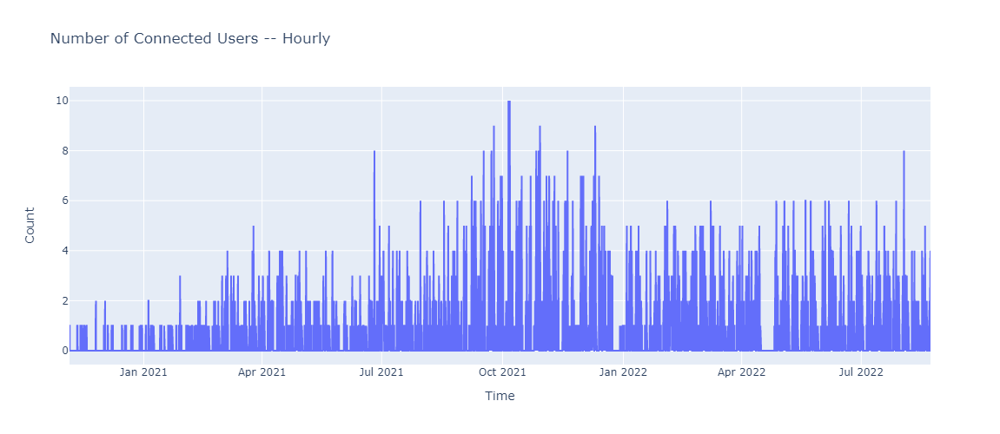

In [25]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=connected_users_hourly_df.index, y=connected_users_hourly_df["Number Connected Users"], hovertext=df_power_time["day"]))

# title and axes labels
fig.update_layout(title="Number of Connected Users -- Hourly", xaxis_title="Time", yaxis_title="Count", height=500)

# fig.show()

#### 5-Minute Aggregated Power Demand

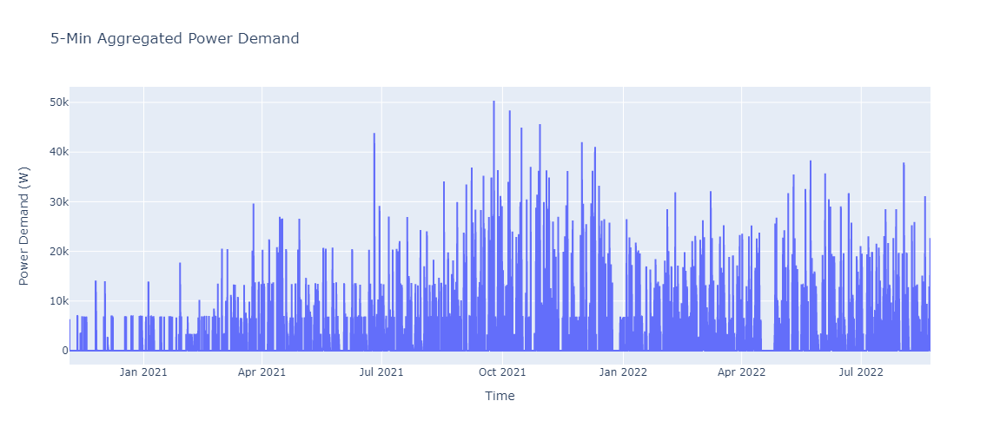

In [26]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_power_time.index, y=df_power_time["power_demand"], hovertext=df_power_time["day"]))

# title and axes labels
fig.update_layout(title="5-Min Aggregated Power Demand", xaxis_title="Time", yaxis_title="Power Demand (W)", height=500)

fig.show(mode='inline', port=6666)

In [27]:
def plot_monthly_power(month , year) :
    """Function takes in a month and year, and generates the 5-minute aggregate
    power plot for that month and year. An empty plot signifies no data for that month and year."""
    if month == 12 :
        month_df = df_power_time.loc[(df_power_time.index >= f"{year}-{month}-01") \
                                     & (df_power_time.index < f"{year + 1}-01-01")] # go to January 
    else : 
        month_df = df_power_time.loc[(df_power_time.index >= f"{year}-{month}-01") \
                                     & (df_power_time.index < f"{year}-{month + 1}-01")]
    
    fig = px.line(month_df , x = month_df.index , y = "power_demand", hover_name="day")
    fig.update_layout(title=f"5 Min Aggregated Power Demand -- {month}/{year}", xaxis_title="Time", yaxis_title="Power Demand (W)")
    fig.show()

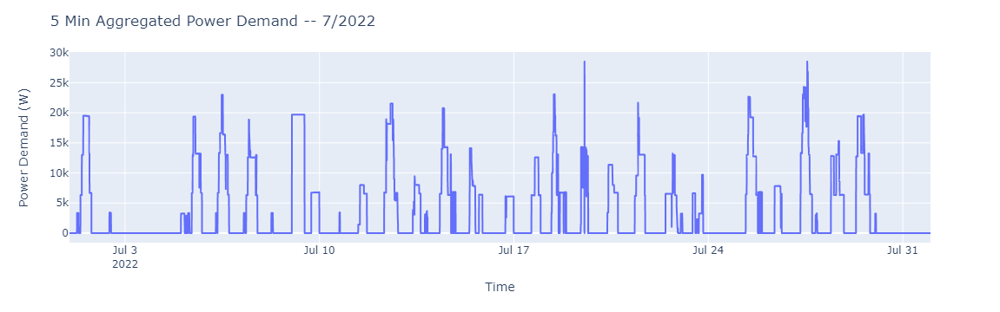

In [28]:
plot_monthly_power(7 , 2022)

#### Hourly Energy Demand

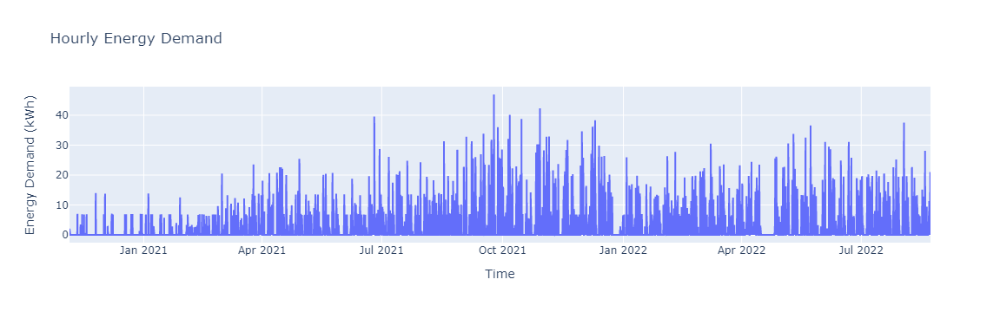

In [29]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = hourly_energy_demand_df.index  , y = hourly_energy_demand_df["energy_demand"]))
fig.update_layout(title = f"Hourly Energy Demand", xaxis_title = "Time", yaxis_title="Energy Demand (kWh)")
# fig.show()

#### Collinearity 

As a sanity check, let's examine the collinearity between the number of users and 5-minute aggregate power. We should expect the aggregate power to scale linearly with the number of connected users.

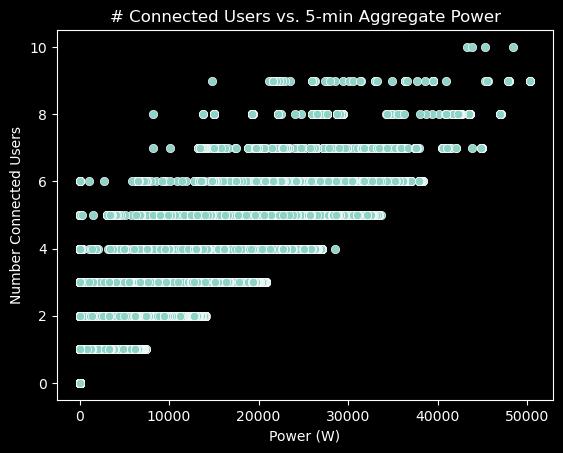

Correlation : 0.9088296045057868


In [30]:
sns.scatterplot(x = df_power_time["power_demand"], y =  connected_users_5min_df["Number Connected Users"])
plt.title("# Connected Users vs. 5-min Aggregate Power")
plt.xlabel("Power (W)")
plt.show()
print(f'Correlation : {np.corrcoef(df_power_time["power_demand"] , connected_users_5min_df["Number Connected Users"])[0][1]}')

In [34]:
df_power_time.columns

Index(['power_demand', 'day', 'Friday', 'Monday', 'Saturday', 'Sunday',
       'Thursday', 'Tuesday', 'Wednesday', 'Federal Holiday',
       'Academic Break'],
      dtype='object')